In [135]:
# data from: https://arcticdata.io/catalog/view/doi%3A10.18739%2FA2FT8DK8Z
import pandas as pd
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np
import glob
import os
import csv

wl_4b = np.asarray([490, 565, 665, 865])
wl_8b = np.asarray([443, 490 ,531 ,565, 610, 665, 705, 865])

In [136]:
def plot_spectra(df, title):
    plt.figure(figsize=(12,6))
    # get the wavelengths from the first column
    wl = df.iloc[:, 0]
    # Loop through the rest of the columns (y-values) and plot them
    for col_name in df.columns[1:]:
        y_values = df[col_name]
        plt.plot(wl, y_values, label=col_name)
    for wl_val in wl_4b:
        plt.axvline(x = wl_val, color = 'r', linewidth=5, alpha=0.25)
    for wl_val in wl_8b:
        plt.axvline(x = wl_val, color = 'b', linewidth=5, alpha=0.25)
    # Add labels and legend to the plot
    plt.ylabel("Reflectance")
    plt.xlabel("Wavelength (nm)")
    plt.grid(True)
    plt.title(title)
    #plt.legend()
    # Show the plot
    plt.show()

def find_row_with_wavelengths(csv_file_path):
    with open(csv_file_path, 'r') as csv_file:
        reader = csv.reader(csv_file)
        for index, row in enumerate(reader):
            if 'Wavelengths' in row:
                return index

class spectral_library:
  def __init__(self, wl):
    self.spectra = np.zeros((0))
    self.spectra8b = np.zeros((0))
    self.spectra4b = np.zeros((0))
    self.wl = wl
    self.wl8b = np.asarray([443, 490 ,531 ,565, 610, 665, 705, 865])
    self.wl4b = np.asarray([490, 565, 665, 865])
    self.nBands = len(wl)
    self.nSpec = 0
    self.names = []
  def add(self, spec, name=''): 
    if len(self.spectra) == 0:
        self.spectra = spec
    else:
        self.spectra = np.row_stack((self.spectra, spec))
    self.names.append(name)
    self.nSpec = self.nSpec + 1
  def resample_planet8b(self):
    self.spectra8b = np.zeros((self.nSpec,8))
    band_ranges = [[431,451],[465,515],[513,549],[547,583],[600,620],[650,682],[697,713],[845,885]]
    for spec_idx in range(self.nSpec):
        for band_idx in range(8):
            low = band_ranges[band_idx][0]
            high = band_ranges[band_idx][1]
            val = 0
            count = 0
            idx_list = np.where((self.wl>low)*(self.wl<high))
            #print(idx_list)
            for i in idx_list[0]:
                #print(spec_idx)
                #print(i)
                #print(np.isfinite(self.spectra[spec_idx,i]))
                if np.isfinite(self.spectra[spec_idx,i]):
                    val = val + self.spectra[spec_idx,i]
                    count = count + 1
            if count>0:
                self.spectra8b[spec_idx,band_idx] = val/count
            else:
                self.spectra8b[spec_idx,band_idx] = np.NaN


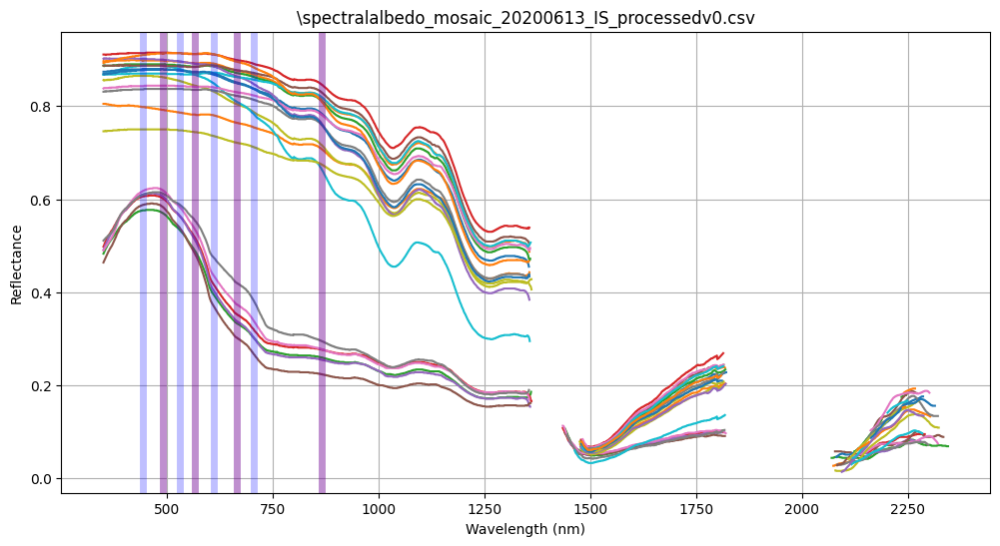

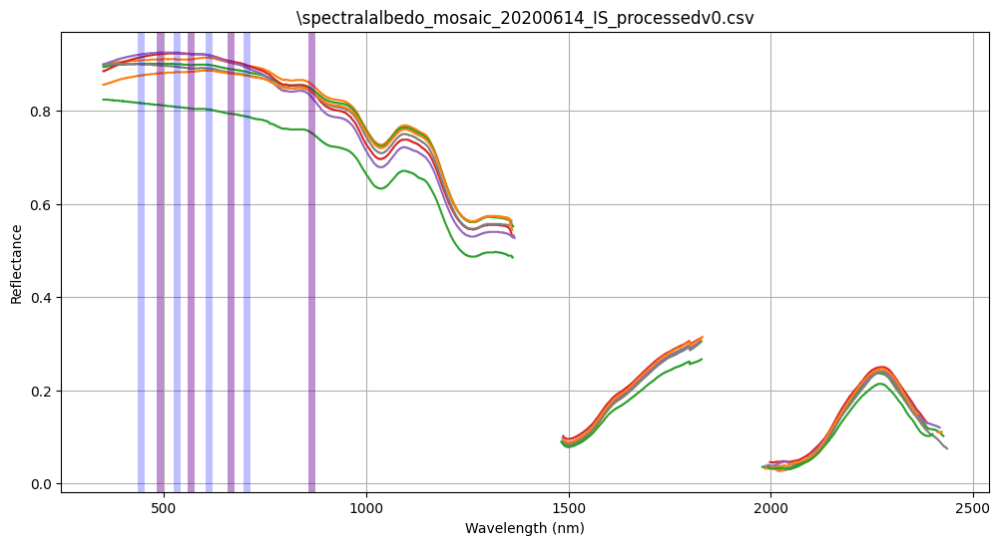

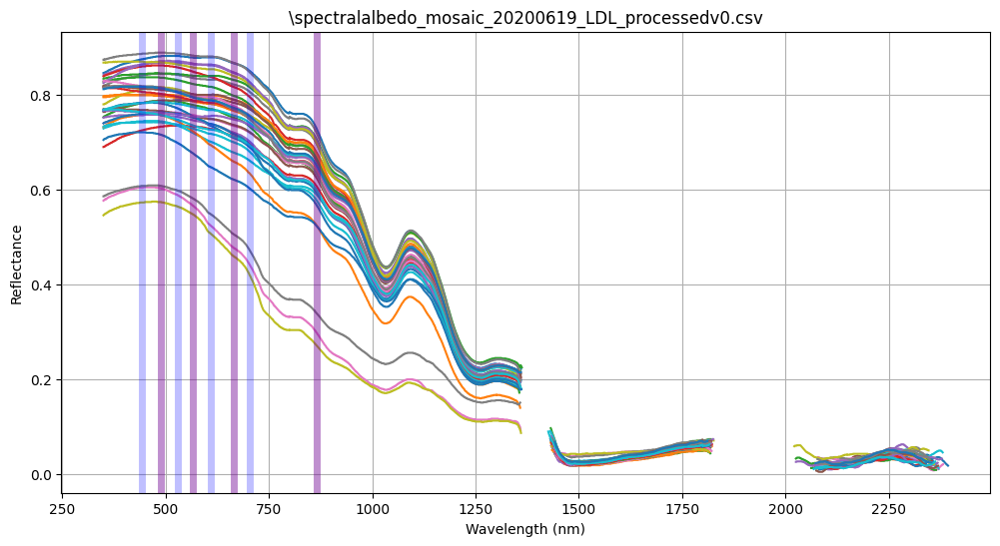

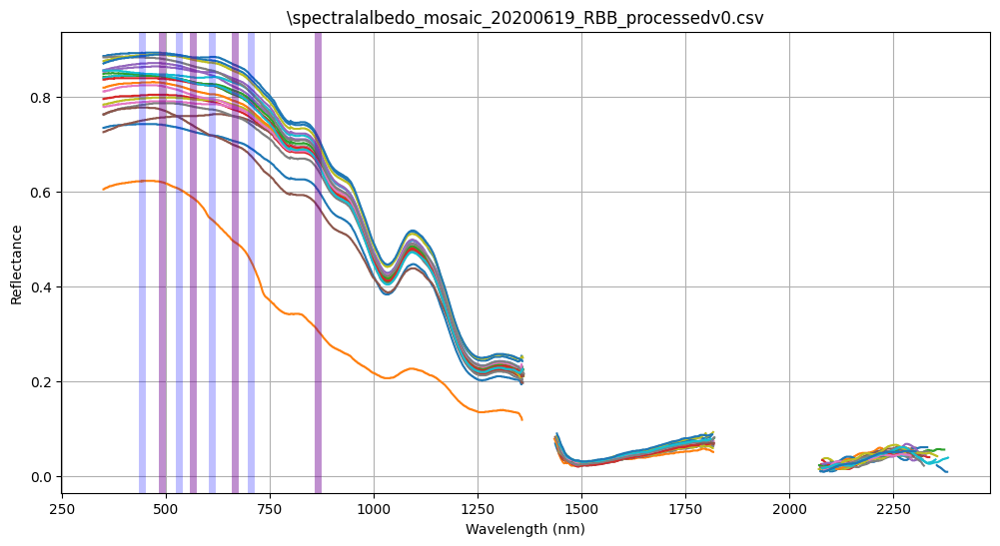

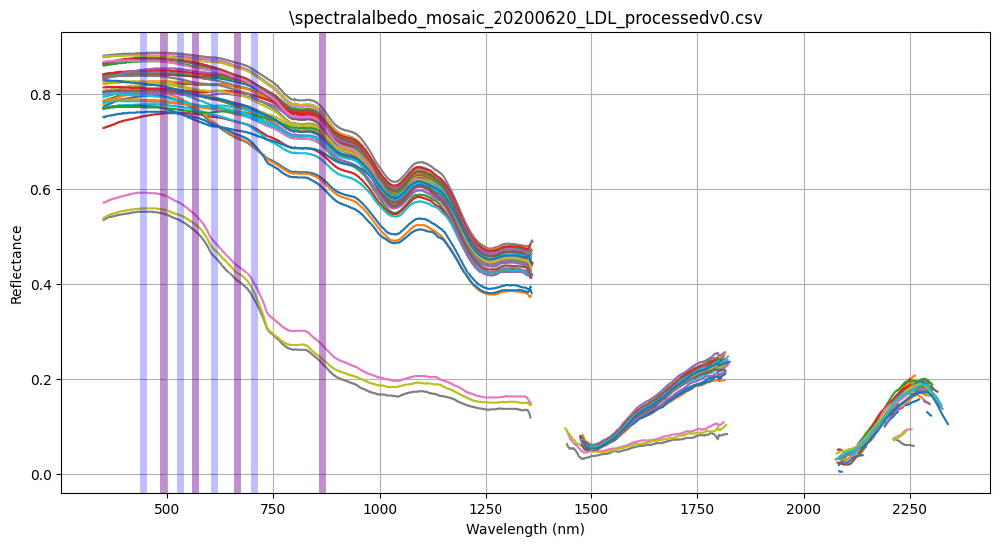

...

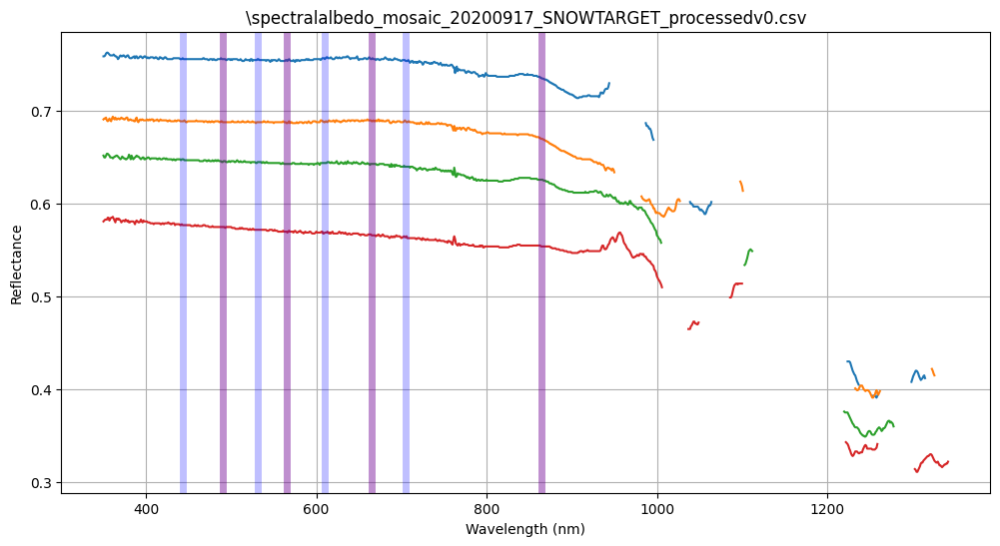

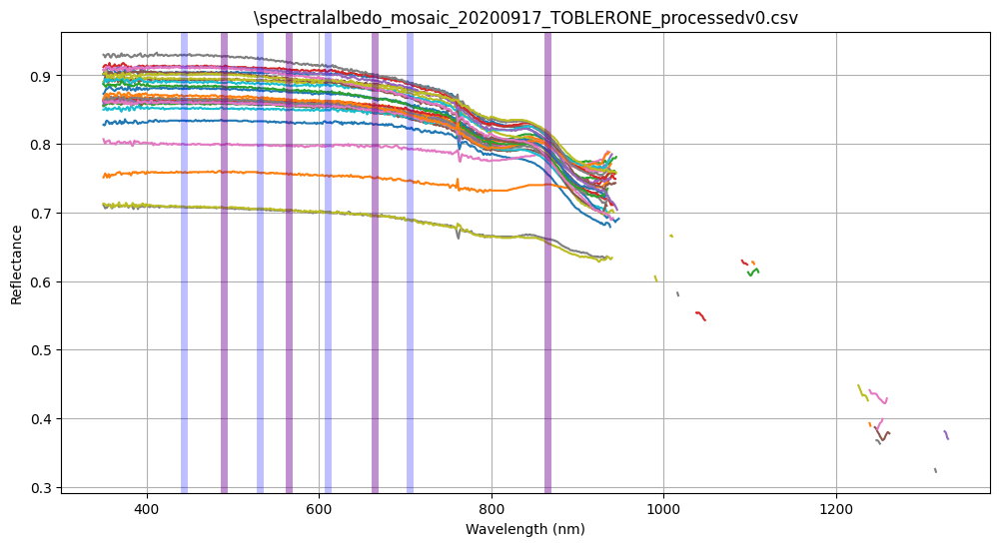

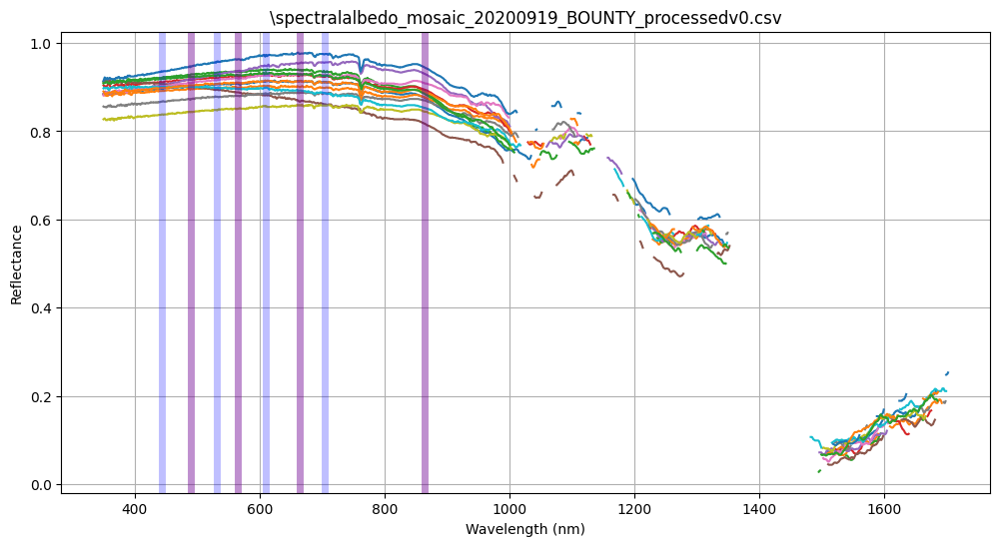

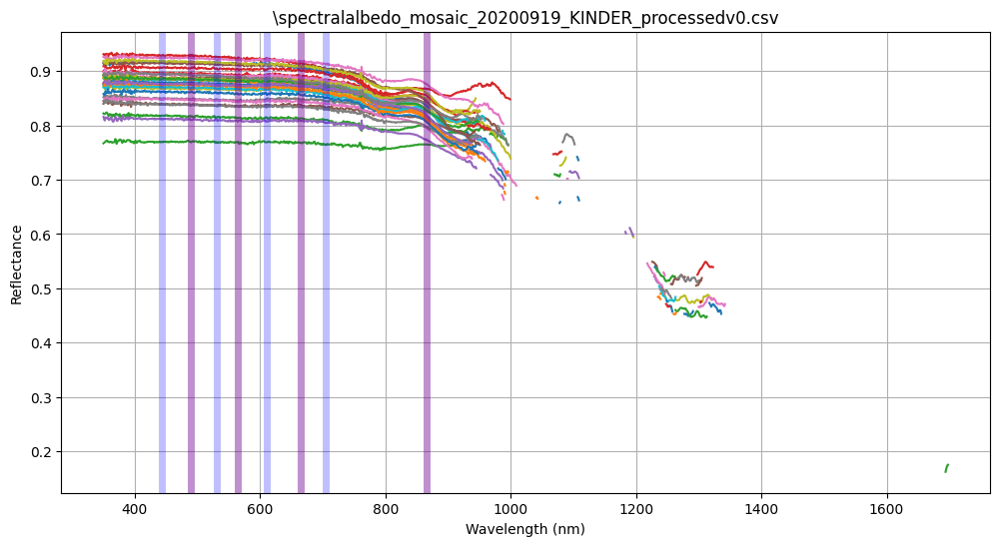

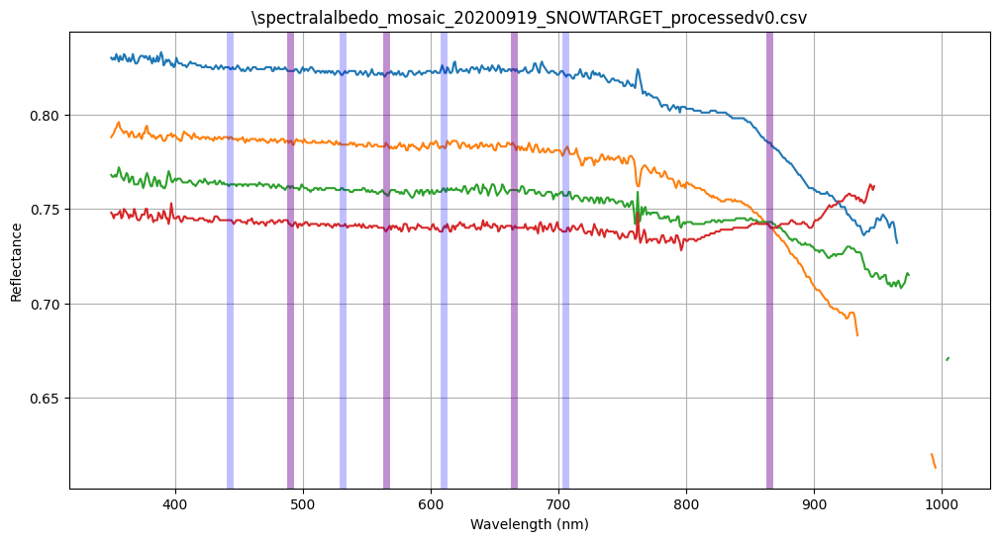

In [137]:
current_directory = os.getcwd()
csv_files = glob.glob(os.path.join(current_directory, "*.csv"))

# get the wavelengths:
idx = find_row_with_wavelengths(csv_files[0])
df = pd.read_csv(csv_files[0], header=idx)
wl = df.iloc[:, 0]
sli = spectral_library(wl)

# Iterate through each CSV file and perform the desired operations
for csv_file in csv_files:
    if csv_file[-3:]=='csv':
        # read the spectra into a dataframe
        idx = find_row_with_wavelengths(csv_file)
        df = pd.read_csv(csv_file, header=idx)
        # add to the spectral library
        for col_name in df.columns[1:]:
            sli.add(df[col_name], name=col_name)
        plot_spectra(df, csv_file[csv_file.rfind('\\'):])

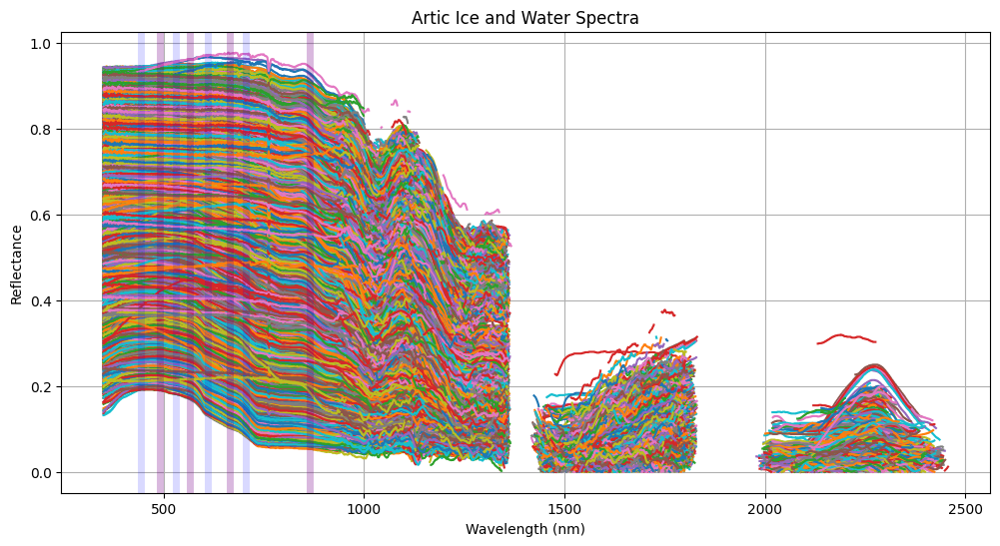

In [138]:
plt.figure(figsize=(12,6))
# Loop through the rest of the columns (y-values) and plot them
for idx in range(sli.nSpec):
    y_values = sli.spectra[idx,:]
    plt.plot(wl, y_values, label=sli.names[idx])
for wl_val in wl_4b:
    plt.axvline(x = wl_val, color = 'r', linewidth=5, alpha=0.15)
for wl_val in wl_8b:
    plt.axvline(x = wl_val, color = 'b', linewidth=5, alpha=0.15)
# Add labels and legend to the plot
plt.ylabel("Reflectance")
plt.xlabel("Wavelength (nm)")
plt.grid(True)
plt.title('Artic Ice and Water Spectra')
#plt.legend()
# Show the plot
plt.show()

In [139]:
sli.resample_planet8b()

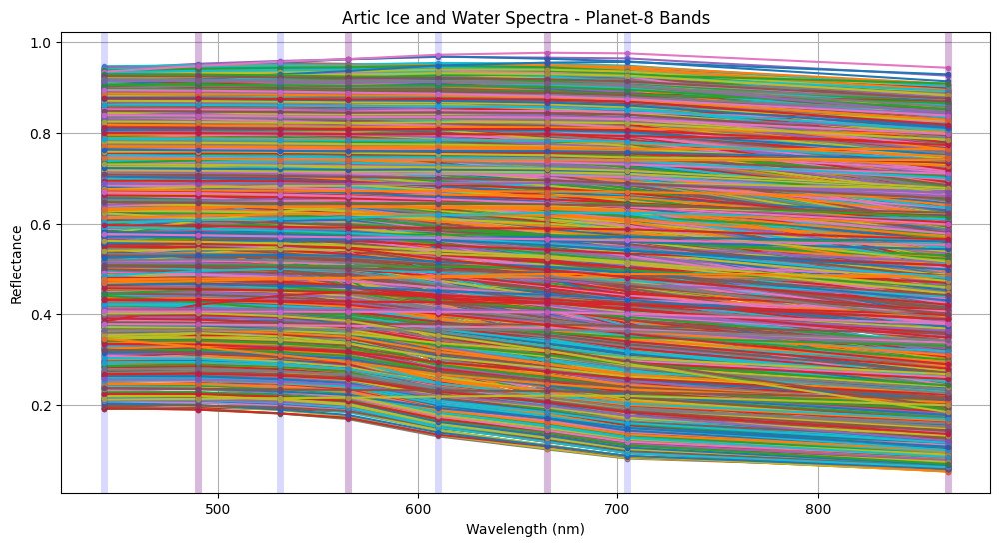

In [140]:
plt.figure(figsize=(12,6))
# Loop through the rest of the columns (y-values) and plot them
for idx in range(sli.nSpec):
    y_values = sli.spectra8b[idx,:]
    plt.plot(sli.wl8b, y_values, label=sli.names[idx], marker='.')
for wl_val in wl_4b:
    plt.axvline(x = wl_val, color = 'r', linewidth=5, alpha=0.15)
for wl_val in wl_8b:
    plt.axvline(x = wl_val, color = 'b', linewidth=5, alpha=0.15)
# Add labels and legend to the plot
plt.ylabel("Reflectance")
plt.xlabel("Wavelength (nm)")
plt.grid(True)
plt.title('Artic Ice and Water Spectra - Planet-8 Bands')
#plt.legend()
# Show the plot
plt.show()

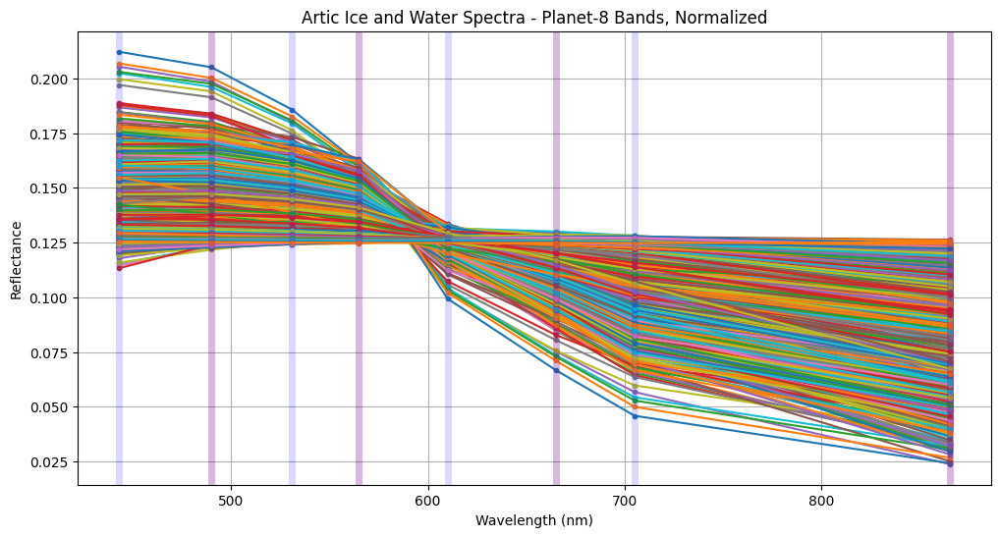

In [141]:
plt.figure(figsize=(12,6))
# Loop through the rest of the columns (y-values) and plot them
for idx in range(sli.nSpec):
    y_values = sli.spectra8b[idx,:]
    plt.plot(sli.wl8b, y_values/np.sum(y_values), label=sli.names[idx], marker='.')
for wl_val in wl_4b:
    plt.axvline(x = wl_val, color = 'r', linewidth=5, alpha=0.15)
for wl_val in wl_8b:
    plt.axvline(x = wl_val, color = 'b', linewidth=5, alpha=0.15)
# Add labels and legend to the plot
plt.ylabel("Reflectance")
plt.xlabel("Wavelength (nm)")
plt.grid(True)
plt.title('Artic Ice and Water Spectra - Planet-8 Bands, Normalized')
#plt.legend()
# Show the plot
plt.show()

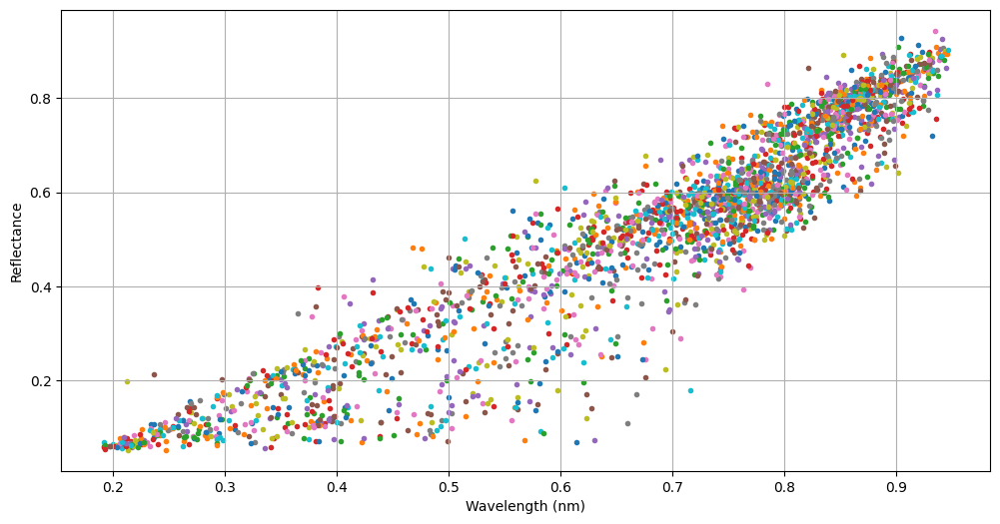

In [142]:
plt.figure(figsize=(12,6))
# Loop through the rest of the columns (y-values) and plot them
for idx in range(sli.nSpec):
    y_values = sli.spectra8b[idx,:]
    plt.scatter(y_values[0],y_values[7], label=sli.names[idx], marker='.')
# Add labels and legend to the plot
plt.ylabel("Reflectance")
plt.xlabel("Wavelength (nm)")
plt.grid(True)
#plt.legend()
# Show the plot
plt.show()

In [143]:
sli.nSpec, sli.nBands

(2712, 2151)

In [144]:
np.arange(20)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])

2388969
(2712, 2151)
0


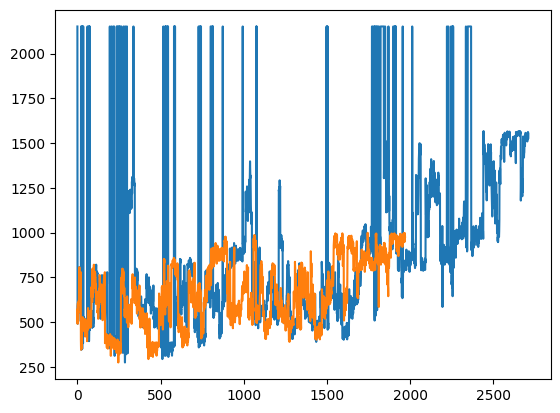

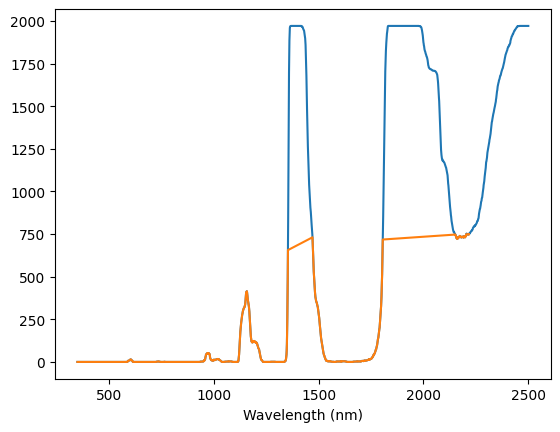

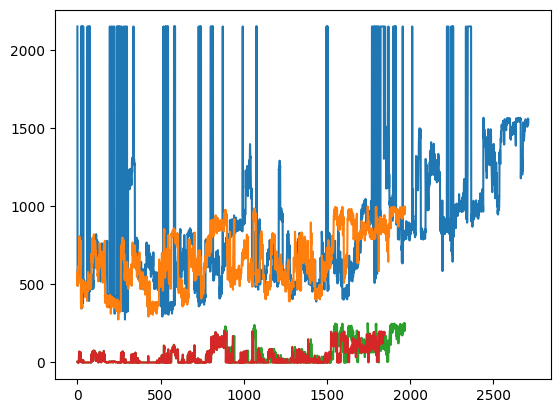

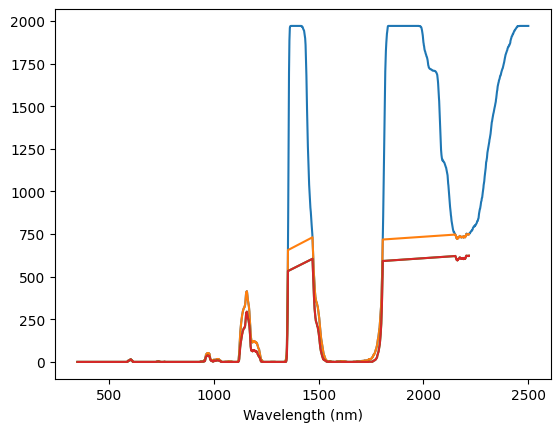

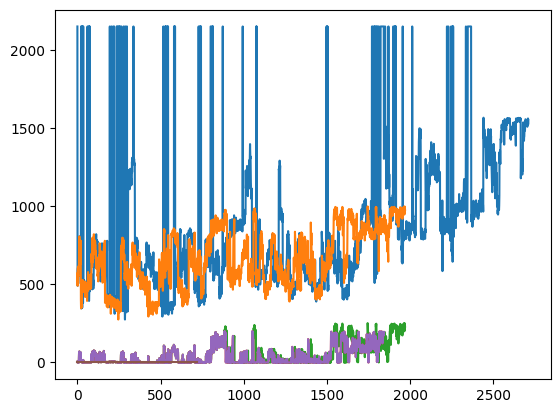

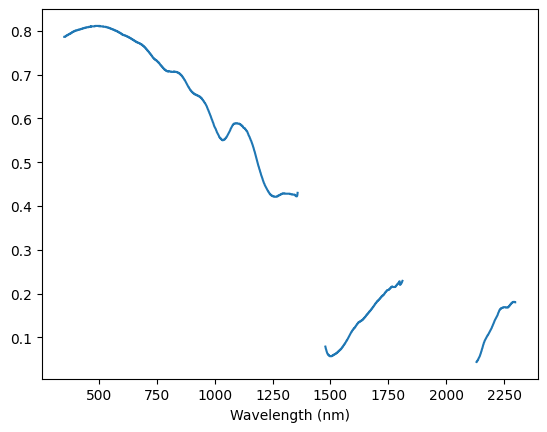

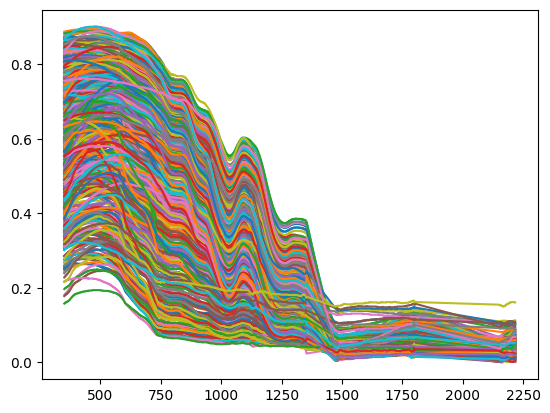

In [145]:
nan_mask = np.isnan(sli.spectra) 
nRows, nCols = nan_mask.shape
row_idx = np.arange(nRows)
col_idx = np.arange(nCols)
print(np.sum(nan_mask))
print(nan_mask.shape)

# reducing number of spectra
col_sum1 = np.sum(nan_mask, axis=1)
nan_mask = nan_mask[col_sum1<1000,:]
row_idx = row_idx[col_sum1<1000]
col_sum2 = np.sum(nan_mask, axis=1)
plt.figure()
plt.plot(col_sum1)
plt.plot(col_sum2)

# reducing number of bands
row_sum1 = np.sum(nan_mask, axis=0)
nan_mask = nan_mask[:,row_sum1<750]
col_idx = col_idx[row_sum1<750]
row_sum2 = np.sum(nan_mask, axis=0)
plt.figure()
plt.plot(wl,row_sum1)
wl2 = wl[row_sum1<750]
plt.plot(wl2,row_sum2)
plt.xlabel("Wavelength (nm)")

# reducing number of spectra
col_sum3 = np.sum(nan_mask, axis=1)
nan_mask = nan_mask[col_sum3<200,:]
row_idx = row_idx[col_sum3<200]
col_sum4 = np.sum(nan_mask, axis=1)
plt.figure()
plt.plot(col_sum1)
plt.plot(col_sum2)
plt.plot(col_sum3)
plt.plot(col_sum4)

# reducing number of bands
row_sum3 = np.sum(nan_mask, axis=0)
nan_mask = nan_mask[:,row_sum3<750]
col_idx = col_idx[row_sum3<750]
row_sum4 = np.sum(nan_mask, axis=0)
plt.figure()
plt.plot(wl,row_sum1)
plt.plot(wl2,row_sum2)
plt.plot(wl2,row_sum3)
wl3 = wl2[row_sum3<750]
plt.plot(wl3,row_sum4)
plt.xlabel("Wavelength (nm)")

# reducing number of spectra
col_sum5 = np.sum(nan_mask, axis=1)
nan_mask = nan_mask[col_sum5<1,:]
row_idx = row_idx[col_sum5<1]
col_sum6 = np.sum(nan_mask, axis=1)
plt.figure()
plt.plot(col_sum1)
plt.plot(col_sum2)
plt.plot(col_sum3)
plt.plot(col_sum4)
plt.plot(col_sum5)
plt.plot(col_sum6)

plt.figure()
plt.plot(wl,sli.spectra[100,:]);
plt.xlabel("Wavelength (nm)")

print(np.sum(nan_mask))
data = sli.spectra[row_idx,:]
data = data[:,col_idx]
plt.figure()
plt.plot(wl3,data.T);

In [146]:
print(data.shape)
pca = PCA(whiten=True, n_components=10)
pca.fit(data)
pca_spec = pca.transform(data).T
print(pca_spec.shape)

(720, 1404)
(10, 720)


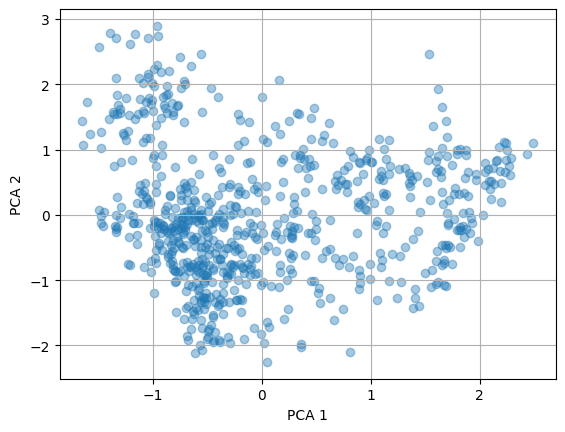

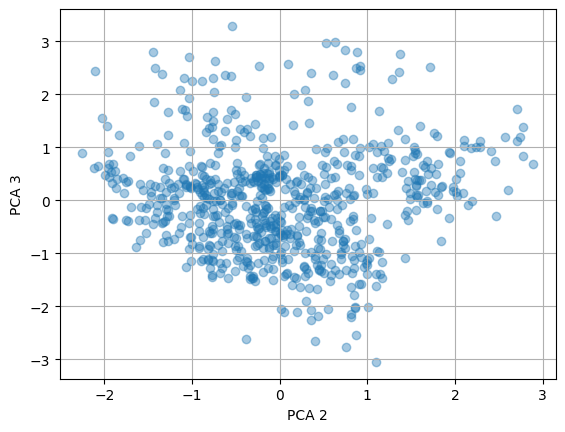

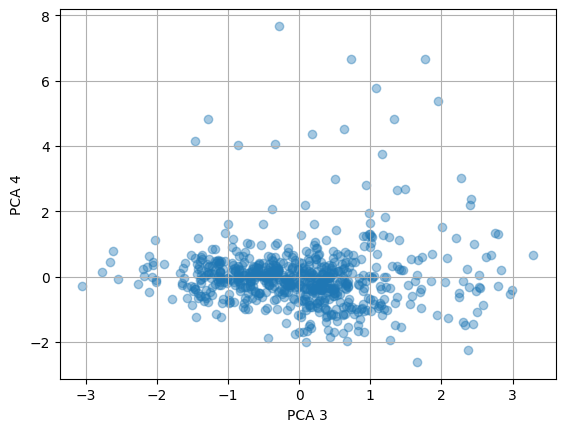

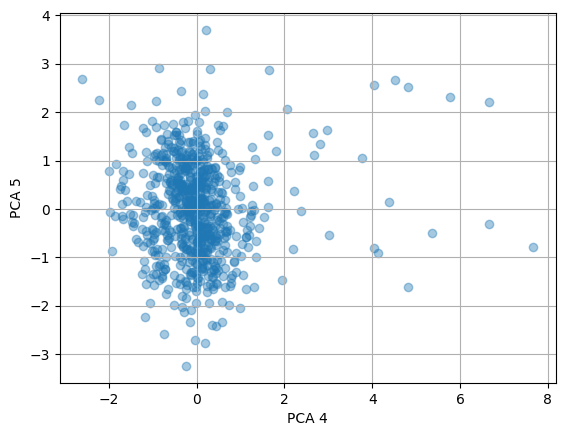

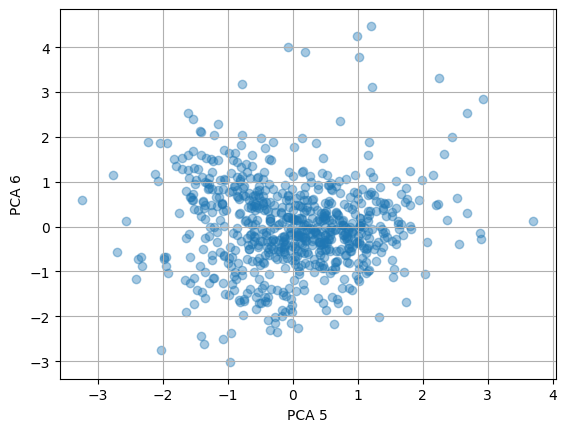

In [147]:
plt.figure()
plt.scatter(pca_spec[0,:],pca_spec[1,:], alpha=0.4)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.grid(True)
plt.figure()
plt.scatter(pca_spec[1,:],pca_spec[2,:], alpha=0.4)
plt.xlabel('PCA 2')
plt.ylabel('PCA 3')
plt.grid(True)
plt.figure()
plt.scatter(pca_spec[2,:],pca_spec[3,:], alpha=0.4)
plt.xlabel('PCA 3')
plt.ylabel('PCA 4')
plt.grid(True)
plt.figure()
plt.scatter(pca_spec[3,:],pca_spec[4,:], alpha=0.4)
plt.xlabel('PCA 4')
plt.ylabel('PCA 5')
plt.grid(True)
plt.figure()
plt.scatter(pca_spec[4,:],pca_spec[5,:], alpha=0.4)
plt.xlabel('PCA 5')
plt.ylabel('PCA 6')
plt.grid(True)

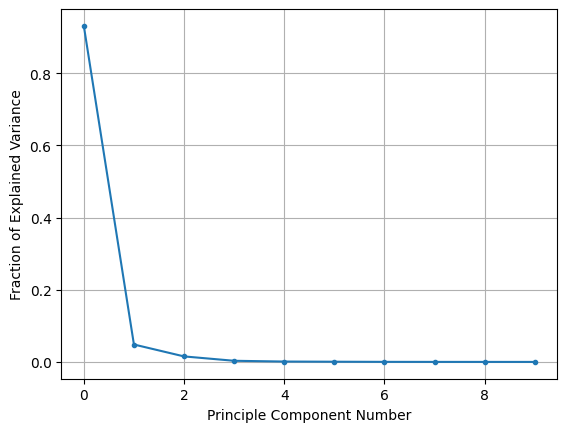

In [148]:
plt.plot(pca.explained_variance_ratio_, marker='.')
plt.xlabel('Principle Component Number')
plt.ylabel('Fraction of Explained Variance')
plt.grid(True)

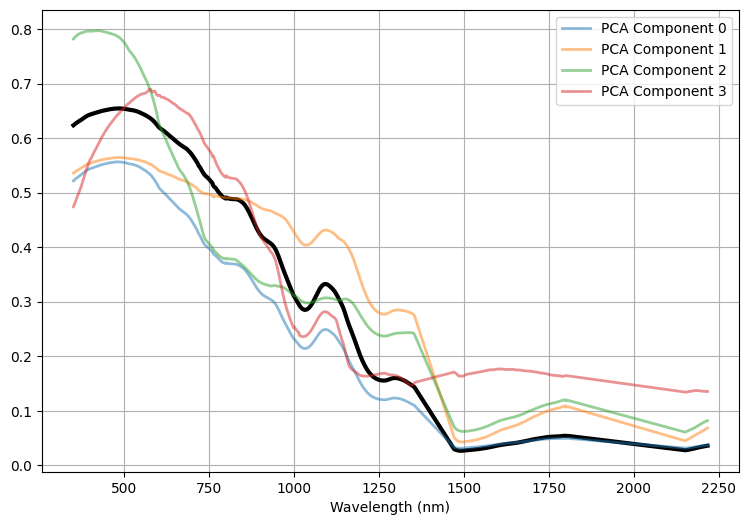

In [153]:
plt.figure(figsize=(9,6))
plt.plot(wl3, pca.mean_, 'k', linewidth=3)
for i in range(4):
    #note: I am multiplying by 2 to see the variation in the PCS better 
    plt.plot(wl3, pca.mean_ + 3*pca.components_[i,:], linewidth=2, label='PCA Component '+str(i), alpha=0.5)
plt.grid(True)
plt.xlabel('Wavelength (nm)')
plt.legend();